In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import scipy.stats as stats
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

In [2]:
# Below command used for see the entire dataset rows and columns in one frame 

pd.pandas.set_option('display.max_columns', None)
pd.pandas.set_option('display.max_rows',None)

# 1. Data Understanding and Preprocessing:

In [3]:
#  Load and inspect the dataset.

In [4]:
df = pd.read_csv('data.csv')

In [5]:
df.shape

(6819, 96)

In [6]:
# Handle missing values appropriately.
df.isnull().sum()

Bankrupt?                                                   0
 ROA(C) before interest and depreciation before interest    0
 ROA(A) before interest and % after tax                     0
 ROA(B) before interest and depreciation after tax          0
 Operating Gross Margin                                     0
 Realized Sales Gross Margin                                0
 Operating Profit Rate                                      0
 Pre-tax net Interest Rate                                  0
 After-tax net Interest Rate                                0
 Non-industry income and expenditure/revenue                0
 Continuous interest rate (after tax)                       0
 Operating Expense Rate                                     0
 Research and development expense rate                      0
 Cash flow rate                                             0
 Interest-bearing debt interest rate                        0
 Tax rate (A)                                               0
 Net Val

In [7]:
# To check whether the data contains duplicate values or not

df.duplicated().sum()

0

In [8]:
df.head(5)

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
0,1,0.370594,0.424389,0.405750,0.601457,0.601457,0.998969,0.796887,0.808809,0.302646,0.780985,1.256969e-04,0.0,0.458143,0.000725,0.0,0.147950,0.147950,0.147950,0.169141,0.311664,0.017560,0.095921,0.138736,0.022102,0.848195,0.688979,0.688979,0.217535,4.980000e+09,0.000327,0.263100,0.363725,0.002259,0.001208,0.629951,0.021266,0.207576,0.792424,0.005024,0.390284,0.006479,0.095885,0.137757,0.398036,0.086957,0.001814,0.003487,1.820926e-04,1.165007e-04,0.032903,0.034164,0.392913,0.037135,0.672775,0.166673,0.190643,0.004094,0.001997,1.473360e-04,0.147308,0.334015,0.276920,0.001036,0.676269,0.721275,0.339077,0.025592,0.903225,0.002022,0.064856,7.010000e+08,6.550000e+09,0.593831,4.580000e+08,0.671568,0.424206,0.676269,0.339077,0.126549,0.637555,0.458609,0.520382,0.312905,0.118250,0,0.716845,0.009219,0.622879,0.601453,0.827890,0.290202,0.026601,0.564050,1,0.016469
1,1,0.464291,0.538214,0.516730,0.610235,0.610235,0.998946,0.797380,0.809301,0.303556,0.781506,2.897851e-04,0.0,0.461867,0.000647,0.0,0.182251,0.182251,0.182251,0.208944,0.318137,0.021144,0.093722,0.169918,0.022080,0.848088,0.689693,0.689702,0.217620,6.110000e+09,0.000443,0.264516,0.376709,0.006016,0.004039,0.635172,0.012502,0.171176,0.828824,0.005059,0.376760,0.005835,0.093743,0.168962,0.397725,0.064468,0.001286,0.004917,9.360000e+09,7.190000e+08,0.025484,0.0068

In [9]:
# this command is use info to get the information about the datatypes

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6819 entries, 0 to 6818
Data columns (total 96 columns):
 #   Column                                                    Non-Null Count  Dtype  
---  ------                                                    --------------  -----  
 0   Bankrupt?                                                 6819 non-null   int64  
 1    ROA(C) before interest and depreciation before interest  6819 non-null   float64
 2    ROA(A) before interest and % after tax                   6819 non-null   float64
 3    ROA(B) before interest and depreciation after tax        6819 non-null   float64
 4    Operating Gross Margin                                   6819 non-null   float64
 5    Realized Sales Gross Margin                              6819 non-null   float64
 6    Operating Profit Rate                                    6819 non-null   float64
 7    Pre-tax net Interest Rate                                6819 non-null   float64
 8    After-tax net Int

In [10]:
# This command is used to find the correlation between the columns which is helpful in feature selection process to short-list the columns

df.corr()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
Bankrupt?,1.000000,-0.260807,-0.282941,-0.273051,-0.100043,-0.099445,-0.000230,-0.008517,-0.008857,-0.016593,-0.008395,-0.006083,-0.024232,-0.072356,-0.023063,-0.109706,-0.165399,-0.165465,-0.164784,-0.219560,-0.077516,-0.004692,-0.142051,-0.201395,-0.000458,-0.015168,-0.037783,-0.036820,-0.009401,-0.044431,0.065329,-0.016858,-0.051345,-0.002211,0.025058,-0.002681,0.012314,0.250161,-0.250161,0.016920,0.176543,0.070455,-0.141111,-0.207857,0.075278,-0.067915,-0.004754,-0.006556,-0.001376,0.072818,0.021089,0.039718,-0.092842,0.002829,-0.193083,-0.086382,-0.044823,-0.100130,-0.003823,0.077921,0.194494,-0.077082,-0.001906,0.000822,-0.020809,-0.147221,0.153828,0.000778,-0.217779,-0.007137,0.139049,0.011929,0.025814,-0.002894,-0.018035,0.000479,0.066328,-0.020809,0.153828,0.139014,-0.070456,-0.043125,-0.115383,-0.058563,0.171306,0.139212,-0.315457,0.035104,-0.005547,-0.100044,-0.180987,0.166812,0.010508,-0.005509,NaN,-0.083048
ROA(C) before interest and depreciation before interest,-0.260807,1.000000,0.940124,0.986849,0.334719,0.332755,0.035725,0.053419,0.049222,0.020501,0.051328,0.066869,0.106461,0.323482,0.048882,0.250761,0.505580,0.505407,0.505281,0.775006,0.379839,-0.015932,0.687201,0.750564,0.000591,0.036511,0.115083,0.115040,0.025234,0.019635,-0.021930,0.079906,0.296158,0.013196,-0.026336,0.003988,-0.022208,-0.26

In [11]:
# This command is used for finding the number of columns that have a positive correlation with the Bankrupt which is our response variable
(df.corr()['Bankrupt?']>=0.15).sum()

8

In [12]:
corrMatrix = df.corr()
corrMatrix

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Operating Gross Margin,Realized Sales Gross Margin,Operating Profit Rate,Pre-tax net Interest Rate,After-tax net Interest Rate,Non-industry income and expenditure/revenue,Continuous interest rate (after tax),Operating Expense Rate,Research and development expense rate,Cash flow rate,Interest-bearing debt interest rate,Tax rate (A),Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Cash Flow Per Share,Revenue Per Share (Yuan ¥),Operating Profit Per Share (Yuan ¥),Per Share Net profit before tax (Yuan ¥),Realized Sales Gross Profit Growth Rate,Operating Profit Growth Rate,After-tax Net Profit Growth Rate,Regular Net Profit Growth Rate,Continuous Net Profit Growth Rate,Total Asset Growth Rate,Net Value Growth Rate,Total Asset Return Growth Rate Ratio,Cash Reinvestment %,Current Ratio,Quick Ratio,Interest Expense Ratio,Total debt/Total net worth,Debt ratio %,Net worth/Assets,Long-term fund suitability ratio (A),Borrowing dependency,Contingent liabilities/Net worth,Operating profit/Paid-in capital,Net profit before tax/Paid-in capital,Inventory and accounts receivable/Net value,Total Asset Turnover,Accounts Receivable Turnover,Average Collection Days,Inventory Turnover Rate (times),Fixed Assets Turnover Frequency,Net Worth Turnover Rate (times),Revenue per person,Operating profit per person,Allocation rate per person,Working Capital to Total Assets,Quick Assets/Total Assets,Current Assets/Total Assets,Cash/Total Assets,Quick Assets/Current Liability,Cash/Current Liability,Current Liability to Assets,Operating Funds to Liability,Inventory/Working Capital,Inventory/Current Liability,Current Liabilities/Liability,Working Capital/Equity,Current Liabilities/Equity,Long-term Liability to Current Assets,Retained Earnings to Total Assets,Total income/Total expense,Total expense/Assets,Current Asset Turnover Rate,Quick Asset Turnover Rate,Working capitcal Turnover Rate,Cash Turnover Rate,Cash Flow to Sales,Fixed Assets to Assets,Current Liability to Liability,Current Liability to Equity,Equity to Long-term Liability,Cash Flow to Total Assets,Cash Flow to Liability,CFO to Assets,Cash Flow to Equity,Current Liability to Current Assets,Liability-Assets Flag,Net Income to Total Assets,Total assets to GNP price,No-credit Interval,Gross Profit to Sales,Net Income to Stockholder's Equity,Liability to Equity,Degree of Financial Leverage (DFL),Interest Coverage Ratio (Interest expense to EBIT),Net Income Flag,Equity to Liability
Bankrupt?,1.000000,-0.260807,-0.282941,-0.273051,-0.100043,-0.099445,-0.000230,-0.008517,-0.008857,-0.016593,-0.008395,-0.006083,-0.024232,-0.072356,-0.023063,-0.109706,-0.165399,-0.165465,-0.164784,-0.219560,-0.077516,-0.004692,-0.142051,-0.201395,-0.000458,-0.015168,-0.037783,-0.036820,-0.009401,-0.044431,0.065329,-0.016858,-0.051345,-0.002211,0.025058,-0.002681,0.012314,0.250161,-0.250161,0.016920,0.176543,0.070455,-0.141111,-0.207857,0.075278,-0.067915,-0.004754,-0.006556,-0.001376,0.072818,0.021089,0.039718,-0.092842,0.002829,-0.193083,-0.086382,-0.044823,-0.100130,-0.003823,0.077921,0.194494,-0.077082,-0.001906,0.000822,-0.020809,-0.147221,0.153828,0.000778,-0.217779,-0.007137,0.139049,0.011929,0.025814,-0.002894,-0.018035,0.000479,0.066328,-0.020809,0.153828,0.139014,-0.070456,-0.043125,-0.115383,-0.058563,0.171306,0.139212,-0.315457,0.035104,-0.005547,-0.100044,-0.180987,0.166812,0.010508,-0.005509,NaN,-0.083048
ROA(C) before interest and depreciation before interest,-0.260807,1.000000,0.940124,0.986849,0.334719,0.332755,0.035725,0.053419,0.049222,0.020501,0.051328,0.066869,0.106461,0.323482,0.048882,0.250761,0.505580,0.505407,0.505281,0.775006,0.379839,-0.015932,0.687201,0.750564,0.000591,0.036511,0.115083,0.115040,0.025234,0.019635,-0.021930,0.079906,0.296158,0.013196,-0.026336,0.003988,-0.022208,-0.26

# 2. Feature Engineering and Selection:

In [13]:
# we are giving a condition so that we can get correlation that have positive + 0.15 and - 0.15 values of correlation
strong_corr = (corrMatrix['Bankrupt?']>=0.15) |  (corrMatrix['Bankrupt?']<-0.15)
strong_corr.sum()

22

In [14]:
pred_cols = (strong_corr[strong_corr].index.to_list())
pred_cols

['Bankrupt?',
 ' ROA(C) before interest and depreciation before interest',
 ' ROA(A) before interest and % after tax',
 ' ROA(B) before interest and depreciation after tax',
 ' Net Value Per Share (B)',
 ' Net Value Per Share (A)',
 ' Net Value Per Share (C)',
 ' Persistent EPS in the Last Four Seasons',
 ' Per Share Net profit before tax (Yuan ¥)',
 ' Debt ratio %',
 ' Net worth/Assets',
 ' Borrowing dependency',
 ' Net profit before tax/Paid-in capital',
 ' Working Capital to Total Assets',
 ' Current Liability to Assets',
 ' Current Liabilities/Equity',
 ' Retained Earnings to Total Assets',
 ' Current Liability to Equity',
 ' Current Liability to Current Assets',
 ' Net Income to Total Assets',
 " Net Income to Stockholder's Equity",
 ' Liability to Equity']

In [15]:
new_df = df[pred_cols]
new_df.shape

(6819, 22)

In [16]:
new_df.corr()

,Bankrupt?,ROA(C) before interest and depreciation before interest,ROA(A) before interest and % after tax,ROA(B) before interest and depreciation after tax,Net Value Per Share (B),Net Value Per Share (A),Net Value Per Share (C),Persistent EPS in the Last Four Seasons,Per Share Net profit before tax (Yuan ¥),Debt ratio %,Net worth/Assets,Borrowing dependency,Net profit before tax/Paid-in capital,Working Capital to Total Assets,Current Liability to Assets,Current Liabilities/Equity,Retained Earnings to Total Assets,Current Liability to Equity,Current Liability to Current Assets,Net Income to Total Assets,Net Income to Stockholder's Equity,Liability to Equity
Bankrupt?,1.000000,-0.260807,-0.282941,-0.273051,-0.165399,-0.165465,-0.164784,-0.219560,-0.201395,0.250161,-0.250161,0.176543,-0.207857,-0.193083,0.194494,0.153828,-0.217779,0.153828,0.171306,-0.315457,-0.180987,0.166812
ROA(C) before interest and depreciation before interest,-0.260807,1.000000,0.940124,0.986849,0.505580,0.505407,0.505281,0.775006,0.750564,-0.261427,0.261427,-0.161671,0.753339,0.259680,-0.210256,-0.142734,0.650217,-0.142734,-0.160725,0.887670,0.274287,-0.143629
ROA(A) before interest and % after tax,-0.282941,0.940124,1.000000,0.955741,0.531799,0.531790,0.531821,0.764828,0.752578,-0.259972,0.259972,-0.161868,0.758234,0.303532,-0.190501,-0.133816,0.718013,-0.133816,-0.195673,0.961552,0.291744,-0.141039
ROA(B) before interest and depreciation after tax,-0.273051,0.986849,0.955741,1.000000,0.502052,0.502000,0.501907,0.764597,0.722940,-0.264734,0.264734,-0.158618,0.726003,0.260151,-0.217186,-0.142879,0.673738,-0.142879,-0.162572,0.912040,0.280617,-0.142838
Net Value Per Share (B),-0.165399,0.505580,0.531799,0.502052,1.000000,0.999342,0.999179,0.755568,0.726321,-0.249146,0.249146,-0.123991,0.706646,0.198620,-0.198546,-0.102098,0.491365,-0.102098,-0.164367,0.493776,0.148693,-0.110850
Net Value Per Share (A),-0.165465,0.505407,0.531790,0.502000,0.999342,1.000000,0.999837,0.755409,0.725956,-0.249925,0.249925,-0.125321,0.705800,0.199598,-0.199086,-0.102539,0.492760,-0.102539,-0.165083,0.493803,0.148872,-0.111797
Net Value Per Share (C),-0.164784,0.505281,0.531821,0.501907,0.999179,0.999837,1.000000,0.755217,0.725825,-0.249463,0.249463,-0.125188,0.705621,0.199475,-0.198721,-0.102431,0.492734,-0.102431,-0.165011,0.493822,0.148906,-0.111682
Persistent EPS in the Last Four Seasons,-0.219560,0.775006,0.764828,0.764597,0.755568,0.755409,0.755217,1.000000,0.955591,-0.177429,0.177429,-0.144138,0.959461,0.253188,-0.097689,-0.094966,0.492078,-0.094966,-0.154690,0.691152,0.222961,-0.114114
Per Share Net profit before tax (Yuan ¥),-0.201395,0.750564,0.752578,0.722940,0.726321,0.725956,0.725825,0.955591,1.000000,-0.158897,0.158897,-0.142138,0.962723,0.238435,-0.079795,-0.089174,0.473736,-0.089174,-0.148721,0.671748,0.218389,-0.107727
Debt ratio %,0.250161,-0.261427,-0.259972,-0.264734,-0.249146,-0.249925,-0.249463,-0.177429,-0.158897,1.000000,-1.000000,0.329109,-0.164110,-0.528797,0.842583,0.343692,-0.235423,0.343692,0.428180,-0.281422,-0.123986,0.349250


In [17]:
# Rename the columns

new_column_names = {
    'Bankrupt?': 'Bankrupt',
    ' ROA(C) before interest and depreciation before interest': 'ROA(C)',
    ' ROA(A) before interest and % after tax': 'ROA(A)',
    ' ROA(B) before interest and depreciation after tax': 'ROA(B)',
    ' Net Value Per Share (B)': 'NVPS(B)',
    ' Net Value Per Share (A)': 'NVPS(A)',
    ' Net Value Per Share (C)': 'NVPS(C)',
    ' Persistent EPS in the Last Four Seasons':'EPS_LAST_FOUR_SEASON',
    ' Per Share Net profit before tax (Yuan ¥)':'PSNP_BTAX',
    ' Debt ratio %': 'Debt_Ratio',
    ' Net worth/Assets': 'Net_Worth/Assets',
    ' Borrowing dependency':'B_D',
    ' Net profit before tax/Paid-in capital': 'Net_Profit_before_Tax/Paid-in_Capital',
    ' Working Capital to Total Assets': 'Working_Capital/Total_Assets',
    ' Current Liability to Assets': 'Current_Liability/Assets',
    ' Current Liabilities/Equity': 'Current_Liabilities/Equity',
    ' Retained Earnings to Total Assets': 'Retained_Earnings/Total_Assets',
    ' Current Liability to Equity':'Current_Liability_to_Equity',
    ' Current Liability to Current Assets':'Current_Liability_to_Current_Assets',
    ' Net Income to Total Assets': 'Net_Income_to_Total_Assets',
    ' Net Income to Stockholder\'s Equity' : 'Net_Income_Stockholder\'s_Equity',
    ' Liability to Equity' : 'Liability_to_Equity'
}

new_df.rename(columns=new_column_names, inplace=True)

C:\Users\Dell\AppData\Local\Temp\ipykernel_17680\3266012227.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df.rename(columns=new_column_names, inplace=True)


In [18]:
new_df.corr()['Bankrupt']

Bankrupt                                 1.000000
ROA(C)                                  -0.260807
ROA(A)                                  -0.282941
ROA(B)                                  -0.273051
NVPS(B)                                 -0.165399
NVPS(A)                                 -0.165465
NVPS(C)                                 -0.164784
EPS_LAST_FOUR_SEASON                    -0.219560
PSNP_BTAX                               -0.201395
Debt_Ratio                               0.250161
Net_Worth/Assets                        -0.250161
B_D                                      0.176543
Net_Profit_before_Tax/Paid-in_Capital   -0.207857
Working_Capital/Total_Assets            -0.193083
Current_Liability/Assets                 0.194494
Current_Liabilities/Equity               0.153828
Retained_Earnings/Total_Assets          -0.217779
Current_Liability_to_Equity              0.153828
Current_Liability_to_Current_Assets      0.171306
Net_Income_to_Total_Assets              -0.315457


# 3. Exploratory Data Analysis (EDA):

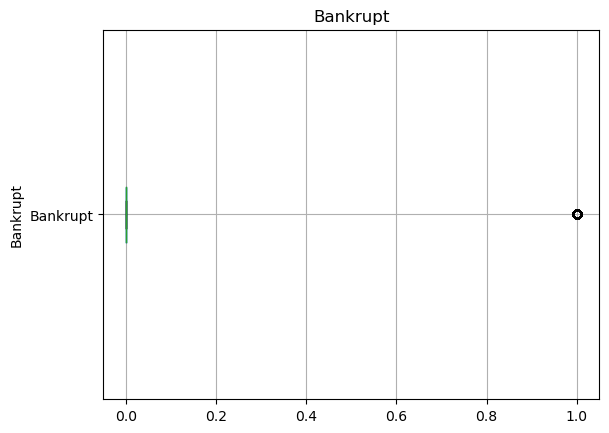

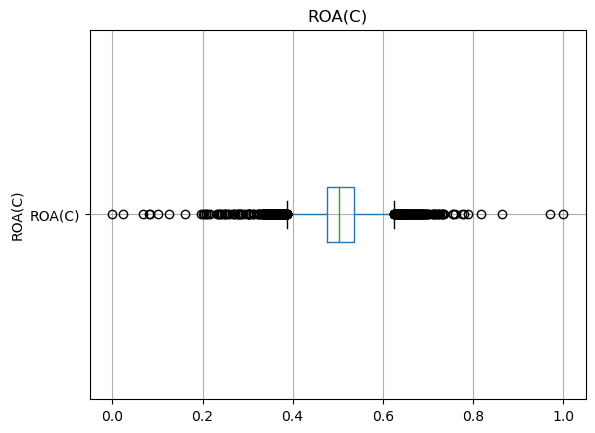

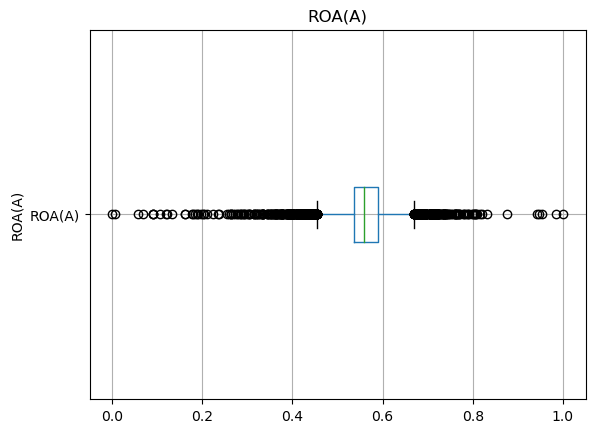

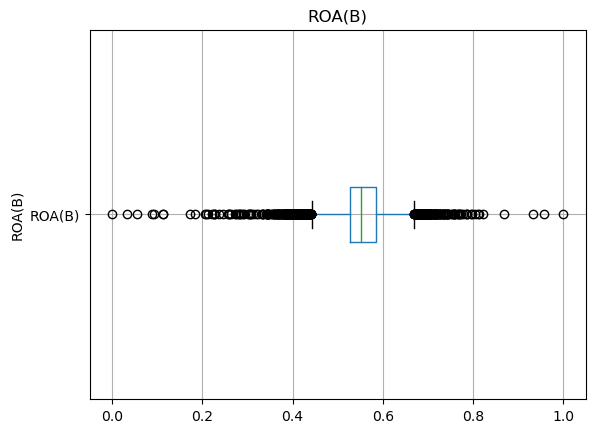

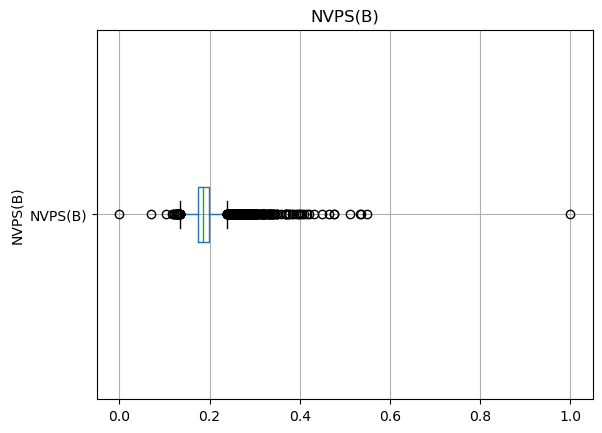

...

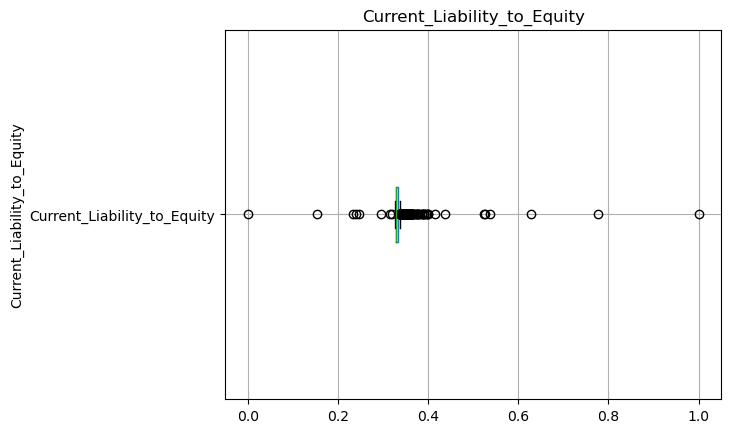

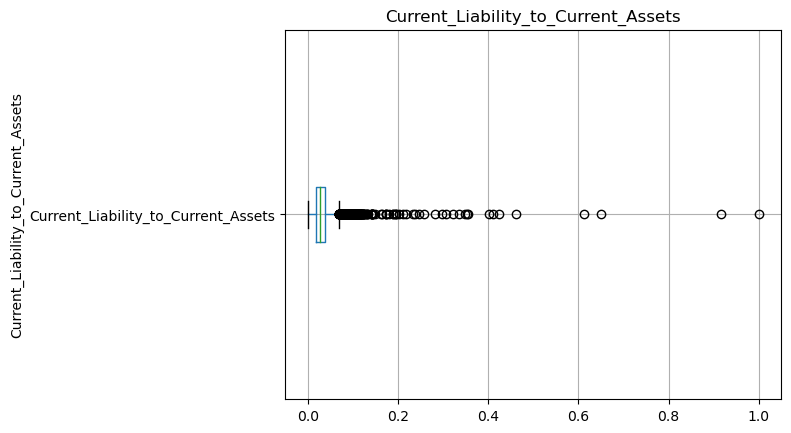

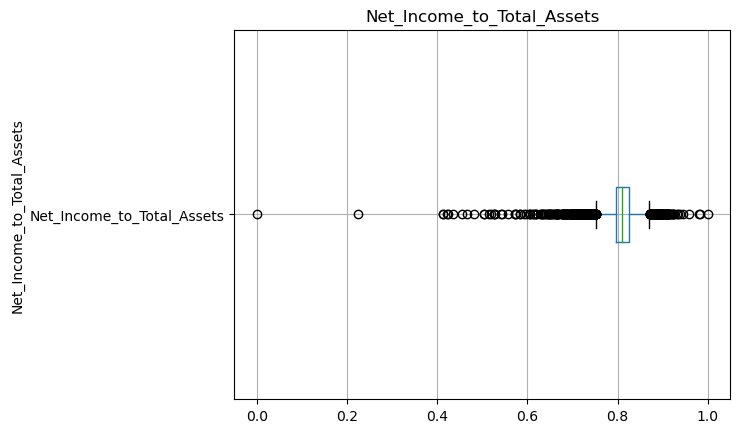

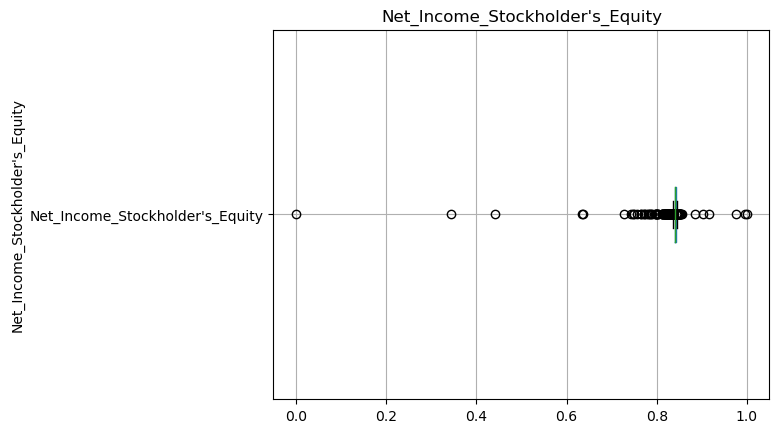

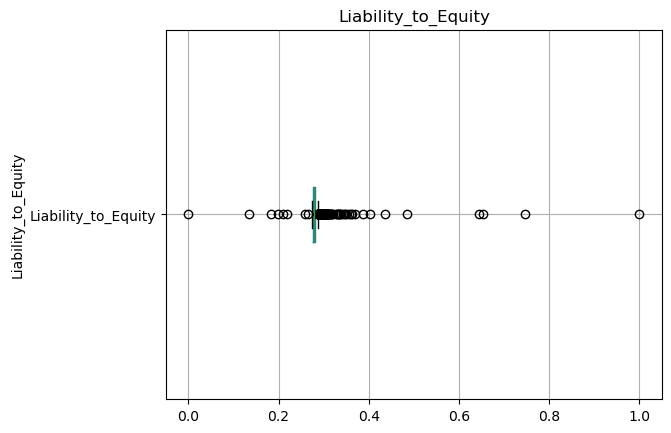

In [19]:
# For loop to print a series of boxplot of the features that we have selected from the correlation coefficient values

for feature in new_df:
    new_df.boxplot(feature, vert=False)
    plt.ylabel(feature)
    plt.title(feature)
    plt.show()

In [20]:
# Calulate Higher and Lower Fence 

def impute(x):
    Q3=new_df[x].quantile(0.75)
    Q1=new_df[x].quantile(0.25)
    IQR=Q3-Q1
    lb=Q1-2.8*(IQR)
    ub=Q3+2.8*(IQR)
    idx=np.where(new_df[x]>ub)
    new_df[x].iloc[idx]=ub
    idx=np.where(new_df[x]<lb)
    new_df[x].iloc[idx]=lb

In [21]:
for column in new_df:
    if column!='Bankrupt':
        impute(column)

C:\Users\Dell\AppData\Local\Temp\ipykernel_17680\476400374.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[x].iloc[idx]=ub
C:\Users\Dell\AppData\Local\Temp\ipykernel_17680\476400374.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[x].iloc[idx]=lb
C:\Users\Dell\AppData\Local\Temp\ipykernel_17680\476400374.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  new_df[x].iloc[idx]=ub
C:\Users\Dell\AppData\Local\Temp\i

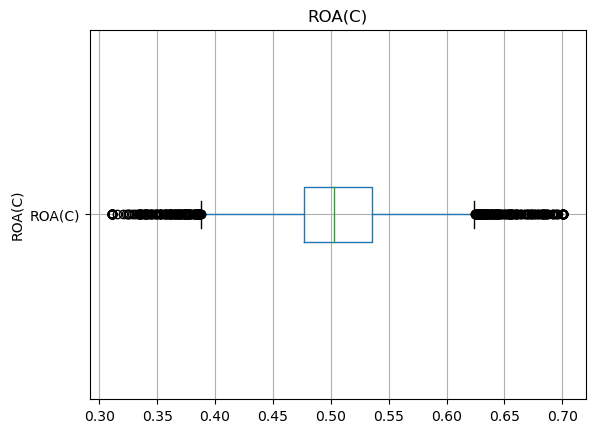

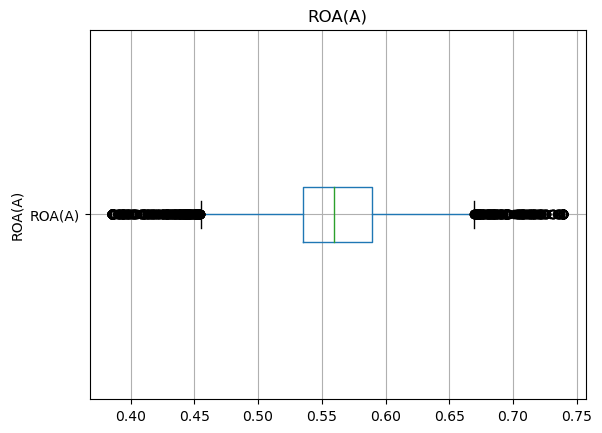

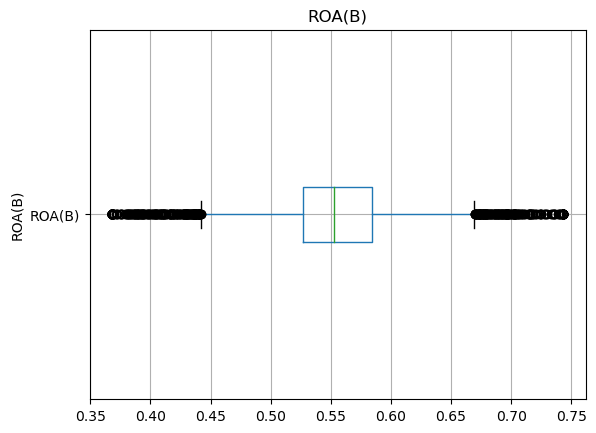

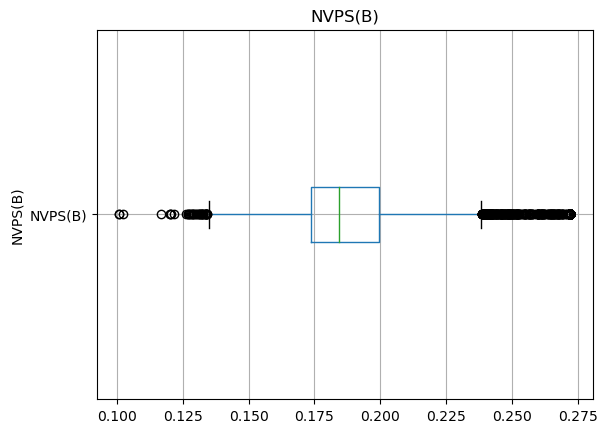

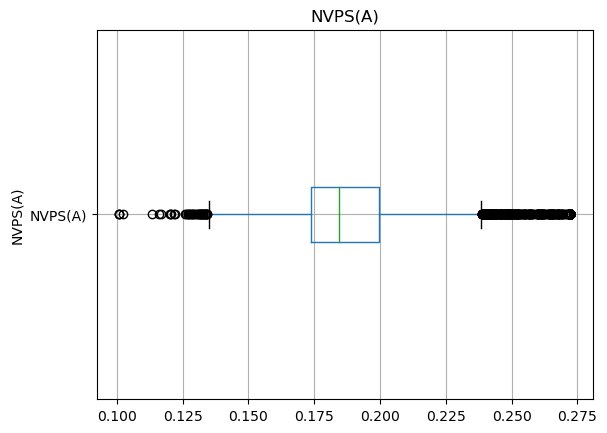

...

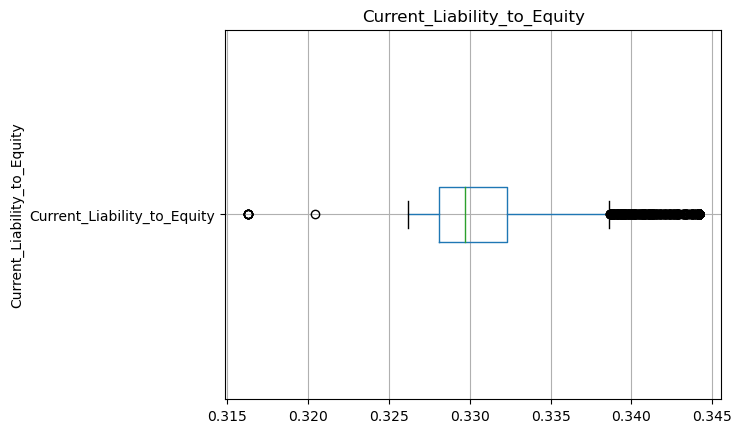

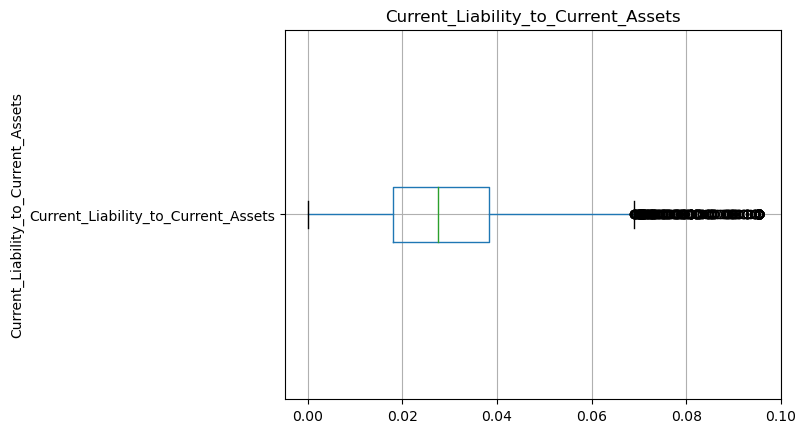

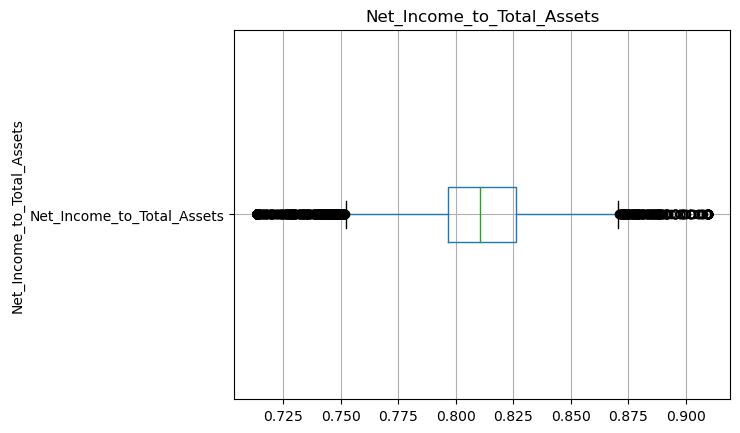

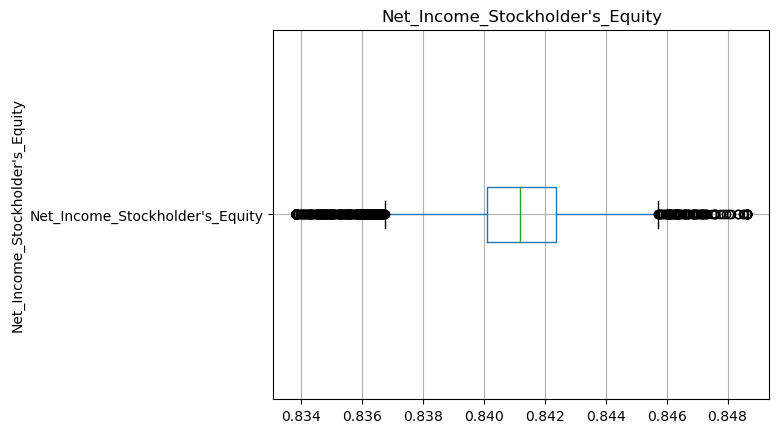

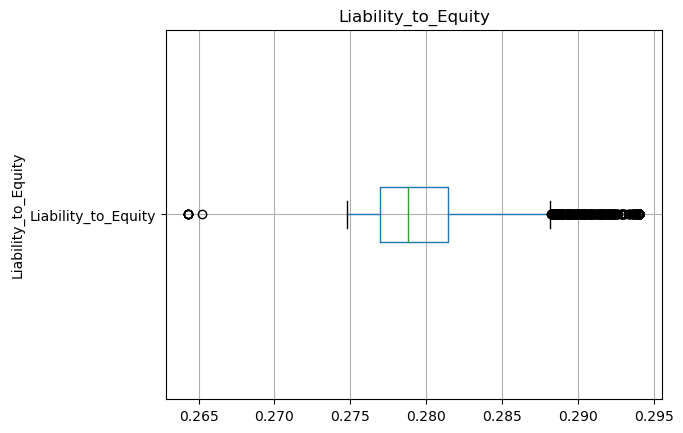

In [22]:
for feature in new_df:
    if feature != 'Bankrupt':
        new_df.boxplot(feature, vert=False)
        plt.ylabel(feature)
        plt.title(feature)
        plt.show()

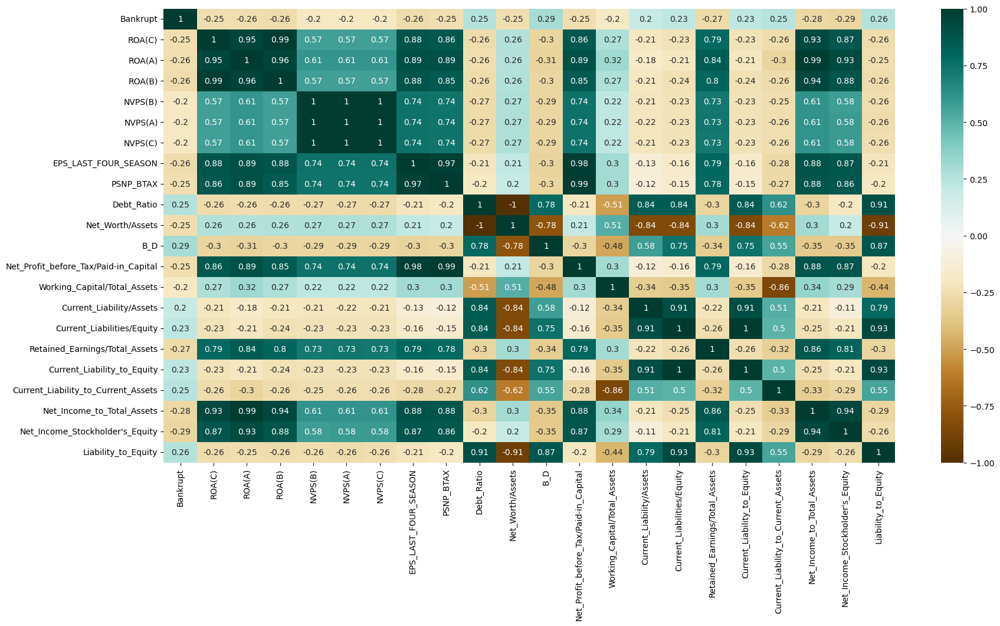

In [23]:
plt.figure(figsize=(20,10))
sns.heatmap(new_df.corr(),cmap="BrBG",annot=True)
plt.show()

# 4. Hypothesis Testing:

In [24]:
significant_features = []
for column in new_df.columns[:-1]:  # Exclude the target variable
    t_stat, p_value = stats.ttest_ind(new_df[column][new_df['Bankrupt'] == 1], new_df[column][new_df['Bankrupt'] == 0])
    if p_value < 0.05:
        significant_features.append(column)

# Display significant features
significant_features

C:\Users\Dell\AppData\Local\Temp\ipykernel_17680\128014019.py:3: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  t_stat, p_value = stats.ttest_ind(new_df[column][new_df['Bankrupt'] == 1], new_df[column][new_df['Bankrupt'] == 0])


['Bankrupt',
 'ROA(C)',
 'ROA(A)',
 'ROA(B)',
 'NVPS(B)',
 'NVPS(A)',
 'NVPS(C)',
 'EPS_LAST_FOUR_SEASON',
 'PSNP_BTAX',
 'Debt_Ratio',
 'Net_Worth/Assets',
 'B_D',
 'Net_Profit_before_Tax/Paid-in_Capital',
 'Working_Capital/Total_Assets',
 'Current_Liability/Assets',
 'Current_Liabilities/Equity',
 'Retained_Earnings/Total_Assets',
 'Current_Liability_to_Equity',
 'Current_Liability_to_Current_Assets',
 'Net_Income_to_Total_Assets',
 "Net_Income_Stockholder's_Equity"]

In [25]:
temp = new_df.iloc[:,:21]

In [26]:
temp

,Bankrupt,ROA(C),ROA(A),ROA(B),NVPS(B),NVPS(A),NVPS(C),EPS_LAST_FOUR_SEASON,PSNP_BTAX,Debt_Ratio,Net_Worth/Assets,B_D,Net_Profit_before_Tax/Paid-in_Capital,Working_Capital/Total_Assets,Current_Liability/Assets,Current_Liabilities/Equity,Retained_Earnings/Total_Assets,Current_Liability_to_Equity,Current_Liability_to_Current_Assets,Net_Income_to_Total_Assets,Net_Income_Stockholder's_Equity
0,1,0.370594,0.424389,0.405750,0.147950,0.147950,0.147950,0.169141,0.138736,0.207576,0.792424,0.390284,0.137757,0.672775,0.147308,0.339077,0.903225,0.339077,0.095329,0.716845,0.833837
1,1,0.464291,0.538214,0.516730,0.182251,0.182251,0.182251,0.208944,0.169918,0.171176,0.828824,0.376760,0.168962,0.751111,0.056963,0.329740,0.931065,0.329740,0.047775,0.795297,0.839969
2,1,0.426071,0.499019,0.472295,0.177911,0.177911,0.193713,0.180581,0.142803,0.207516,0.792484,0.379093,0.148036,0.829502,0.098162,0.334777,0.909903,0.334777,0.025346,0.774670,0.836774
3,1,0.399844,0.451265,0.457733,0.154187,0.154187,0.154187,0.193722,0.148603,0.151465,0.848535,0.379743,0.147561,0.725754,0.098715,0.331509,0.906902,0.331509,0.067250,0.739555,0.834697
4,1,0.465022,0.538432,0.522298,0.167502,0.167502,0.167502,0.212537,0.168412,0.106509,0.893491,0.375025,0.167461,0.751822,0.110195,0.330726,0.913850,0.330726,0.047725,0.795016,0.839973
5,1,0.388680,0.415177,0.419134,0.155577,0.155577,0.155577,0.174435,0.138811,0.180427,0.819573,0.381448,0.137825,0.686729,0.139002,0.335534,0.903041,0.335534,0.095329,0.713577,0.833837
6,0,0.390923,0.445704,0.436158,0.158822,0.158822,0.158822,0.161482,0.128945,0.216102,0.783898,0.384999,0.127939,0.729416,0.115920,0.337392,0.911441,0.337392,0.060765,0.736619,0.833837
7,0,0.508361,0.570922,0.559077,0.176984,0.176984,0.176984,0.225206,0.180462,0.108202,0.891798,0.374219,0.179519,0.797005,0.087042,0.329804,0.935449,0.329804,0.030201,0.815350,0.841459
8,0,0.488519,0.545137,0.543284,0.184189,0.184189,0.184189,0.218398,0.173157,0.058591,0.941409,0.370253,0.172159,0.813738,0.058060,0.328093,0.935200,0.328093,0.021710,0.803647,0.840487
9,0,0.495686,0.550916,0.542963,0.177447,0.177447,0.177447,0.217831,0.176621,0.121293,0.878707,0.374509,0.175658,0.825696,0.094563,0.330409,0.938290,0.330409,0.025494,0.804195,0.840688


# 5. Modeling:

In [27]:
x_train = new_df[:5600]

In [28]:
x_test = new_df[5600:]

In [29]:
y_train = x_train.Bankrupt
y_test = x_test.Bankrupt

In [30]:
x_train=x_train.drop(['Bankrupt'],axis =1)
x_test = x_test.drop(['Bankrupt'],axis =1)

In [31]:
import statsmodels.api as sm

In [32]:
mod2 = sm.Logit(y_train,x_train).fit()

Optimization terminated successfully.
         Current function value: 0.092860
         Iterations 11


In [33]:
print(mod2.summary())

                           Logit Regression Results                           
Dep. Variable:               Bankrupt   No. Observations:                 5600
Model:                          Logit   Df Residuals:                     5580
Method:                           MLE   Df Model:                           19
Date:                Mon, 17 Jun 2024   Pseudo R-squ.:                  0.3973
Time:                        22:33:54   Log-Likelihood:                -520.02
converged:                       True   LL-Null:                       -862.83
Covariance Type:            nonrobust   LLR p-value:                3.998e-133
                                            coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------
ROA(C)                                  -21.6261     12.230     -1.768      0.077     -45.597       2.344
ROA(A)                                   47.5287  

In [34]:
logistic_model = LogisticRegression()

In [35]:
logistic_model.fit(x_train, y_train)

LogisticRegression()

In [36]:
y_pred = logistic_model.predict(x_test)

In [37]:
from sklearn.metrics import classification_report, accuracy_score

# 6. Model Interpretation and Insights

In [38]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.99      1.00      0.99      1199
           1       0.60      0.15      0.24        20

    accuracy                           0.98      1219
   macro avg       0.79      0.57      0.62      1219
weighted avg       0.98      0.98      0.98      1219



In [39]:
print(f"Accuracy : {accuracy_score(y_test, y_pred)}")

Accuracy : 0.9844134536505332


In [40]:
print(confusion_matrix(y_test,y_pred))

[[1197    2]
 [  17    3]]


In [41]:
# In this model we got the accuracy of 98% with a precision of 99% and recall 100%.
# This model can be said as Overfitted model as the data was baised so the model predicted values that we more baised.

# Another method by changing the sample size

In [42]:
new_df[new_df.Bankrupt==0]

,Bankrupt,ROA(C),ROA(A),ROA(B),NVPS(B),NVPS(A),NVPS(C),EPS_LAST_FOUR_SEASON,PSNP_BTAX,Debt_Ratio,Net_Worth/Assets,B_D,Net_Profit_before_Tax/Paid-in_Capital,Working_Capital/Total_Assets,Current_Liability/Assets,Current_Liabilities/Equity,Retained_Earnings/Total_Assets,Current_Liability_to_Equity,Current_Liability_to_Current_Assets,Net_Income_to_Total_Assets,Net_Income_Stockholder's_Equity,Liability_to_Equity
6,0,0.390923,0.445704,0.436158,0.158822,0.158822,0.158822,0.161482,0.128945,0.216102,0.783898,0.384999,0.127939,0.729416,0.115920,0.337392,0.911441,0.337392,0.060765,0.736619,0.833837,0.292504
7,0,0.508361,0.570922,0.559077,0.176984,0.176984,0.176984,0.225206,0.180462,0.108202,0.891798,0.374219,0.179519,0.797005,0.087042,0.329804,0.935449,0.329804,0.030201,0.815350,0.841459,0.278607
8,0,0.488519,0.545137,0.543284,0.184189,0.184189,0.184189,0.218398,0.173157,0.058591,0.941409,0.370253,0.172159,0.813738,0.058060,0.328093,0.935200,0.328093,0.021710,0.803647,0.840487,0.276423
9,0,0.495686,0.550916,0.542963,0.177447,0.177447,0.177447,0.217831,0.176621,0.121293,0.878707,0.374509,0.175658,0.825696,0.094563,0.330409,0.938290,0.330409,0.025494,0.804195,0.840688,0.279388
10,0,0.482475,0.567543,0.538198,0.182925,0.182925,0.182925,0.218966,0.178579,0.103577,0.896423,0.374180,0.177611,0.751204,0.032087,0.327485,0.942829,0.327485,0.047166,0.814111,0.841337,0.278356
11,0,0.444401,0.549717,0.498956,0.173865,0.173865,0.173865,0.204689,0.172479,0.094386,0.905614,0.373113,0.171526,0.769114,0.047995,0.328042,0.932955,0.328042,0.033712,0.804887,0.840650,0.277892
12,0,0.491152,0.551570,0.543391,0.169399,0.169399,0.169399,0.219344,0.174286,0.144662,0.855338,0.377307,0.173290,0.760000,0.095672,0.331114,0.930140,0.331114,0.043514,0.803260,0.840702,0.281113
13,0,0.474041,0.533308,0.523690,0.171548,0.171548,0.171548,0.212915,0.168863,0.106570,0.893430,0.373151,0.167861,0.791910,0.069166,0.329035,0.930763,0.329035,0.028902,0.794158,0.839910,0.278518
14,0,0.506703,0.575829,0.569838,0.180566,0.180566,0.180566,0.226435,0.178881,0.089639,0.910361,0.373692,0.177920,0.802391,0.027638,0.327227,0.940252,0.327227,0.015553,0.819715,0.841624,0.277668
15,0,0.513821,0.571086,0.558756,0.174329,0.174329,0.181788,0.223787,0.182421,0.099072,0.900928,0.373545,0.179828,0.791991,0.053385,0.328300,0.933541,0.328300,0.025813,0.815419,0.841399,0.278124


In [43]:
new_df_zero=new_df[new_df.Bankrupt==0].sample(350)

In [44]:
len(new_df_zero)

350

In [45]:
new_df[new_df.Bankrupt!=0]

,Bankrupt,ROA(C),ROA(A),ROA(B),NVPS(B),NVPS(A),NVPS(C),EPS_LAST_FOUR_SEASON,PSNP_BTAX,Debt_Ratio,Net_Worth/Assets,B_D,Net_Profit_before_Tax/Paid-in_Capital,Working_Capital/Total_Assets,Current_Liability/Assets,Current_Liabilities/Equity,Retained_Earnings/Total_Assets,Current_Liability_to_Equity,Current_Liability_to_Current_Assets,Net_Income_to_Total_Assets,Net_Income_Stockholder's_Equity,Liability_to_Equity
0,1,0.370594,0.424389,0.405750,0.147950,0.147950,0.147950,0.169141,0.138736,0.207576,0.792424,0.390284,0.137757,0.672775,0.147308,0.339077,0.903225,0.339077,0.095329,0.716845,0.833837,0.290202
1,1,0.464291,0.538214,0.516730,0.182251,0.182251,0.182251,0.208944,0.169918,0.171176,0.828824,0.376760,0.168962,0.751111,0.056963,0.329740,0.931065,0.329740,0.047775,0.795297,0.839969,0.283846
2,1,0.426071,0.499019,0.472295,0.177911,0.177911,0.193713,0.180581,0.142803,0.207516,0.792484,0.379093,0.148036,0.829502,0.098162,0.334777,0.909903,0.334777,0.025346,0.774670,0.836774,0.290189
3,1,0.399844,0.451265,0.457733,0.154187,0.154187,0.154187,0.193722,0.148603,0.151465,0.848535,0.379743,0.147561,0.725754,0.098715,0.331509,0.906902,0.331509,0.067250,0.739555,0.834697,0.281721
4,1,0.465022,0.538432,0.522298,0.167502,0.167502,0.167502,0.212537,0.168412,0.106509,0.893491,0.375025,0.167461,0.751822,0.110195,0.330726,0.913850,0.330726,0.047725,0.795016,0.839973,0.278514
5,1,0.388680,0.415177,0.419134,0.155577,0.155577,0.155577,0.174435,0.138811,0.180427,0.819573,0.381448,0.137825,0.686729,0.139002,0.335534,0.903041,0.335534,0.095329,0.713577,0.833837,0.285087
29,1,0.416126,0.470235,0.463783,0.156209,0.156209,0.156209,0.177839,0.139640,0.219609,0.780391,0.392590,0.138625,0.703730,0.198285,0.344157,0.908948,0.344157,0.065816,0.750431,0.833837,0.293599
30,1,0.462195,0.536034,0.514428,0.145506,0.145506,0.145506,0.202515,0.165549,0.228890,0.771110,0.393359,0.164565,0.673325,0.141037,0.342349,0.892695,0.342349,0.095329,0.787082,0.838259,0.294063
54,1,0.453030,0.516572,0.505595,0.156799,0.156799,0.156799,0.200151,0.158018,0.210358,0.789642,0.392384,0.157017,0.715124,0.089798,0.334301,0.920882,0.334301,0.086458,0.777094,0.837053,0.290904
55,1,0.472091,0.538814,0.517051,0.148203,0.148203,0.148203,0.206013,0.167960,0.235299,0.764701,0.393359,0.167310,0.662360,0.201894,0.344157,0.912826,0.344157,0.094806,0.791982,0.839162,0.294063


In [46]:
new_df_one = new_df[new_df.Bankrupt!=0].sample(220)

In [47]:
len(new_df_one)

220

In [48]:
new_bank = pd.concat([new_df_zero,new_df_one], axis=0)

In [49]:
len(new_bank)

570

In [50]:
X_train, X_test, y_train, y_test = train_test_split(new_bank.drop('Bankrupt', axis=1), new_bank['Bankrupt'], test_size=0.2)

In [51]:
X_train = sm.add_constant(X_train,prepend=False)
X_test = sm.add_constant(X_test,prepend=False)

In [52]:
mod2 = sm.Logit(y_train,X_train).fit()

Optimization terminated successfully.
         Current function value: 0.312932
         Iterations 13


In [53]:
print(mod2.summary())

                           Logit Regression Results                           
Dep. Variable:               Bankrupt   No. Observations:                  456
Model:                          Logit   Df Residuals:                      436
Method:                           MLE   Df Model:                           19
Date:                Mon, 17 Jun 2024   Pseudo R-squ.:                  0.5285
Time:                        22:33:59   Log-Likelihood:                -142.70
converged:                       True   LL-Null:                       -302.68
Covariance Type:            nonrobust   LLR p-value:                 1.598e-56
                                            coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------
ROA(C)                                  -40.1431     23.404     -1.715      0.086     -86.014       5.728
ROA(A)                                   -0.5864  

In [54]:
logistic_model=LogisticRegression()

In [55]:
logistic_model.fit(X_train,y_train)

LogisticRegression()

In [56]:
y_pred = logistic_model.predict(X_test)

In [57]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.76      0.96      0.85        67
           1       0.90      0.57      0.70        47

    accuracy                           0.80       114
   macro avg       0.83      0.76      0.77       114
weighted avg       0.82      0.80      0.79       114



In [58]:
# In this model we got the accuracy of 80 % with a precision of 83% and recall of 76%.

In [59]:
print(f'Accuracy: {accuracy_score(y_test, y_pred)}')

Accuracy: 0.7982456140350878


In [60]:
print(confusion_matrix(y_test,y_test))

[[67  0]
 [ 0 47]]
